In [1]:
import sys,re,os,time,datetime
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import folium
%matplotlib inline

In [2]:
df = pd.read_csv(os.getcwd()+"/data/THOR_DATA_WWII_DATA_Product_20160822.csv",sep=',',error_bad_lines=False)

/Users/readywater/anaconda/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2717: DtypeWarning: Columns (15,28,32,33,34,36,38,40,42,43,48,53,54,56,58,61,67,73,74,75) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
df.columns.values

array(['WWII_ID', 'ID', 'MASTER_INDEX_NUMBER', 'THEATER', 'MSNDATE', 'DAY',
       'MONTH', 'YEAR', 'NAF', 'COUNTRY_FLYING_MISSION',
       'TGT_COUNTRY_CODE', 'COUNTRY_NAME', 'LOCATION_NAME',
       'TARGET_TYPE_DESCRIPTION', 'TARGET_ID_CODE', 'TGT_INDUSTRY_CODE',
       'TARGET_INDUSTRY_DESCRIPTION', 'SOURCE_LAT', 'SOURCE_LON', 'LAT',
       'LON', 'UNIT_ID', 'MDS', 'AIRCRAFT_NAME', 'MSN_TYPE',
       'TARGET_PRIORITY', 'TARGET_PRIORITY_EXPLANATION', 'ATTACKING_AC',
       'ALTITUDE', 'ALTITUDE_FEET', 'NUMBER_OF_HE', 'TYPE_OF_HE', 'LBS_HE',
       'TONS_OF_HE', 'NUMBER_OF_IC', 'TYPE_OF_IC', 'LBS_IC', 'TONS_OF_IC',
       'NUMBER_OF_FRAG', 'TYPE_OF_FRAG', 'LBS_FRAG', 'TONS_OF_FRAG',
       'TOTAL_LBS', 'TOTAL_TONS', 'SOURCE_LAUNCH_BASE',
       'SOURCE_LAUNCH_BASE_COUNTRY', 'SOURCE_LAUNCH_BASE_LAT',
       'SOURCE_LAUNCH_BASE_LONG', 'SORTIE_DUPE', 'TOTAL_AC_LOST',
       'TOTAL_AC_DAMAGED', 'AIRBORNE_AC', 'NUMBER_OF_AC_DROPPING_BOMBS',
       'TIME_OVER_TARGET', 'SIGHTING_METHOD_CODE'

In [4]:
df[['LAT','LON']] = df[['LAT','LON']].apply(lambda x: pd.to_numeric(x, errors='ignore'))
df['LAT'] = df['LAT'].apply(lambda x: x if x<1000 else x-900)
df['LON'] = df['LON'].apply(lambda x: x if x<1000 else x-900)
germany = df[(df['COUNTRY_NAME']=='Germany')]
df.head(2)

,WWII_ID,ID,MASTER_INDEX_NUMBER,THEATER,MSNDATE,DAY,MONTH,YEAR,NAF,COUNTRY_FLYING_MISSION,...,MISSION_COMMENTS,SOURCE,DATABASE_EDIT_COMMENTS,SPEED__MPH_,DOR,YEAR_,MONTH_,DAY_,MSNDATE_,COUNTRY_NAME_SAV
0,1,1,NaN,MTO,00:00.0,15.0,8.0,1943.0,12 AF,USA,...,NaN,NaN,NaN,NaN,10-JUN-16,1943.0,8.0,15.0,19430815,Italy
1,2,2,9366.0,PTO,00:00.0,15.0,8.0,1943.0,5 AF,USA,...,NaN,NaN,NaN,NaN,10-JUN-16,1943.0,8.0,15.0,19430815,NEW GUINEA


/Users/readywater/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


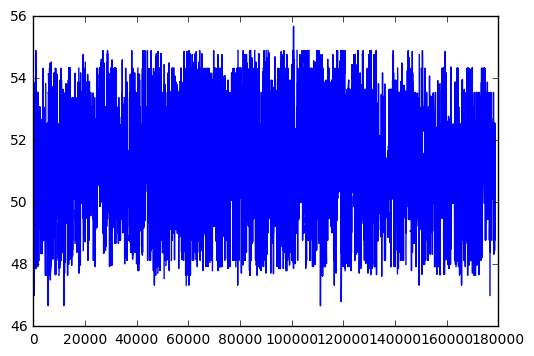

In [7]:
germany["LAT"] = germany["LAT"][np.abs(germany["LAT"]-germany["LAT"].mean())<=(3*germany["LAT"].std())]
plt.plot(germany["LAT"])
plt.show()

/Users/readywater/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


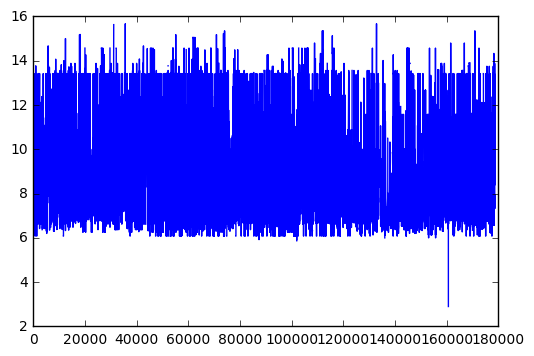

In [10]:
germany["LON"] = germany["LON"][np.abs(germany["LON"]-germany["LON"].mean())<=(3*germany["LON"].std())]
plt.plot(germany["LON"])
plt.show()

In [11]:
from folium import plugins
mapa = folium.Map([52.5, 13.4],
                  zoom_start=10,
                  tiles='cartodbpositron')

In [12]:
mapa.add_children(plugins.HeatMap(germany[["LAT","LON"]].values))
mapa

In [14]:
mapa.add_children(plugins.MarkerCluster(germany[["LAT","LON"]].values))

In [ ]:
mapa